In [57]:
# !pip install pywaffle
# !pip install spacy
# !pip install plotnine
# !pip install great_tables
# !pip install wordcloud

In [58]:

import sqlite3
import os
import pandas as pd 

db_path = os.path.join("..", "..", "data", "speeches.db")
conn = sqlite3.connect(db_path)
df = pd.read_sql_query("SELECT * FROM Transcriptions", conn)
conn.close()

df




,id,speech_id,timestamp,duration,text
0,1,1,00:00:00-00:00:22 (22 sec),None,"[Audience chants ""USA""] Well, that was good ti..."
1,2,1,00:00:22-00:00:34 (12 sec),None,"We appreciate it. Thank you, Navy. Thank you v..."
2,3,1,00:00:34-00:01:03 (29 sec),None,They do. And let me say to all of the incredib...
3,4,1,00:01:03-00:01:06 (3 sec),None,"You know, a lot of people don't. [Laughs] [Aud..."
4,5,1,00:01:06-00:01:37 (31 sec),None,And it's a true honor to be here with the thou...
...,...,...,...,...,...
120363,120364,889,02:14:23-02:14:52 (29 sec),None,And the people of America have never lost fait...
120364,120365,889,02:14:52-02:16:06 (73 sec),None,"And perhaps most beautifully of all, we have m..."
120365,120366,889,02:16:06-02:16:37 (31 sec),None,"We are going to have hope, harmony, opportunit..."
120366,120367,889,02:16:37-02:17:02 (25 sec),None,"This has been truly an honor. It's, uh, seldom..."


#Cleaning the DB#

In [59]:
df.set_index('id')

,speech_id,timestamp,duration,text
id,,,,
1,1,00:00:00-00:00:22 (22 sec),None,"[Audience chants ""USA""] Well, that was good ti..."
2,1,00:00:22-00:00:34 (12 sec),None,"We appreciate it. Thank you, Navy. Thank you v..."
3,1,00:00:34-00:01:03 (29 sec),None,They do. And let me say to all of the incredib...
4,1,00:01:03-00:01:06 (3 sec),None,"You know, a lot of people don't. [Laughs] [Aud..."
5,1,00:01:06-00:01:37 (31 sec),None,And it's a true honor to be here with the thou...
...,...,...,...,...
120364,889,02:14:23-02:14:52 (29 sec),None,And the people of America have never lost fait...
120365,889,02:14:52-02:16:06 (73 sec),None,"And perhaps most beautifully of all, we have m..."
120366,889,02:16:06-02:16:37 (31 sec),None,"We are going to have hope, harmony, opportunit..."


In [60]:
import re
df['duration']=df['timestamp'].str.extract(r'\(([^ ]*)')
df['duration'].unique()

array(['22', '12', '29', '3', '31', '20', '5', '40', '30', '23', '26',
       '28', '25', '11', '35', '21', '34', '27', '32', '24', '17', '42',
       '18', '45', '50', '15', '16', '19', '33', '38', '44', '9', '37',
       '39', '36', '46', '10', '49', '41', '48', '51', '58', '4', '1',
       '6', '43', '56', '8', '291', '', '14', '2', '7', '13', '47', '52',
       '64', '53', '67', '63', '74', '103', '55', '57', '76', '66', '72',
       '61', '62', '65', '83', '92', '59', '78', '75', '154', '638', '70',
       '71', '54', '73', '69', '84', '94', '80', '60', '104', '204',
       '114', '227', '79', '81', '68', '105', '89', '191', '124', '77',
       '152', '143', '155', '82', '151', '85', '108', '87', '127', '192',
       '88', '96', '113', '119', '136', '389', '268', '171', '175', '245',
       '331', '220', '148', '177', '106', '170', '211', '139', '283',
       '216', '183', '186', '117', '99', '147', '144', '98', '116', '215',
       '257', '203', '93', '209', '150', '131', '110', 

We see that there are nan and ''

In [61]:
df[df['duration']==''].text.sample(10)
#that cannot be replaced by 1
df[df['duration'].isna()].text.sample(10)
#this aswell


92953     But to achieve this future, we must break free...
91677     He has absolutely trashed President Obama's si...
91909                                     Change is coming.
101445    We need a new, rational American foreign polic...
101514    A strong and smart America is an America that ...
99634     The decision to overthrow the regime in Libya,...
101313    America First will be the major and overriding...
93449     We are going to unleash an American Energy Rev...
91670                               America needs a change.
91489     Newly-released FBI documents made public today...
Name: text, dtype: object

linear regression to estimate the duration based on the number of characters

In [62]:
df_train = df[(df['duration'] != '') & (df['duration'].notna())]
df_train['duration']=df_train['duration'].astype(int)
Y=df_train['duration']
Y_mean=Y.mean()
X=df_train.text.str.len()
X_mean=X.mean()
b=sum((Xi-X_mean)*(Yi-Y_mean) for Xi,Yi in zip(X,Y))/sum((Xi-X_mean)**2 for Xi in X)
a=Y_mean-b*Y_mean
a,b

C:\Users\nicol\AppData\Local\Temp\ipykernel_24916\3781742271.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


(np.float64(23.062908404056152), np.float64(0.06749542961952261))

In [63]:
mask = (df['duration'] == '') | (df['duration'].isna())
df.loc[mask, 'pred'] = a + b * df.loc[mask, 'text'].str.len()
df.loc[mask, ['text', 'pred']].sample(5)


,text,pred
97694,Hillary Clinton recently said of the VA scanda...,30.689892
101346,Our manufacturing trade deficit with the world...,32.714755
91678,Bill has a different view. Here is what bill s...,26.437680
91658,The homicide rate last year experienced its la...,28.800020
56422,Be careful.,23.805358


not so bad I guess but can definitely be improved (la variance de la durée est beaucoup plus importante quand il y a peu de caractères)

# Focus sur un mot : Biden

In [64]:
import re 
phrases=[]
for extrait in df['text']:
    splited=re.split(r'[.!?]+',str(extrait))
    splited=[s.strip() for s in splited]
    phrases.extend(splited)

In [65]:
len(phrases)

827915

In [66]:
len([p for p in phrases if "Biden" in p])
#Trump has said Biden +7000 times in official speeches

7177

In [67]:
len([p for p in phrases if "much" in p.lower()])

14001

In [68]:
from collections import Counter
mots=" ".join(phrases).split()
Counter(mots)

Counter({'the': 248293,
         'to': 198121,
         'and': 168088,
         'I': 157756,
         'a': 150277,
         'of': 131767,
         'you': 111927,
         'that': 91523,
         'in': 86905,
         'it': 86468,
         'have': 79624,
         'we': 75242,
         'And': 72744,
         'they': 64596,
         'is': 58337,
         '--': 58202,
         'going': 58173,
         'our': 47827,
         'We': 47061,
         'for': 46791,
         'was': 46455,
         'are': 42456,
         'be': 41008,
         'people': 39714,
         'this': 36479,
         'do': 35463,
         'will': 34361,
         'with': 34005,
         'They': 33729,
         'all': 33013,
         "don't": 32860,
         'You': 31781,
         'not': 31720,
         'But': 31502,
         'know': 30720,
         'on': 30264,
         'he': 28207,
         'want': 28156,
         'very': 27944,
         'great': 27927,
         'like': 27621,
         'but': 27271,
         'so': 27117,
 

# Transformation des textes en token

In [69]:
import nltk
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('punkt_tab')
nltk.download('genesis')
nltk.download('wordnet')
nltk.download('omw-1.4')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\nicol\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\nicol\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt_tab to
[nltk_data]     C:\Users\nicol\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package genesis to
[nltk_data]     C:\Users\nicol\AppData\Roaming\nltk_data...
[nltk_data]   Package genesis is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\nicol\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\nicol\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


True

In [70]:
!python -m spacy download en_core_web_sm

     ---------------------------------------- 0.0/12.8 MB ? eta -:--:--
     ------ --------------------------------- 2.1/12.8 MB 13.0 MB/s eta 0:00:01
     ------------------- -------------------- 6.3/12.8 MB 16.1 MB/s eta 0:00:01
     --------------------------------- ----- 11.0/12.8 MB 18.1 MB/s eta 0:00:01
     --------------------------------------- 12.8/12.8 MB 18.2 MB/s eta 0:00:00
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')



[notice] A new release of pip is available: 25.1.1 -> 25.3
[notice] To update, run: python.exe -m pip install --upgrade pip


In [71]:
import re

clean_list = [
    re.sub(r'\[.*?\]', '', line).strip()
    for line in phrases
    if isinstance(line, str) and line.strip()
]
clean_text = ' '.join(clean_list)
clean_list[:5]


["Well, that was good timing, wasn't it",
 'We had to get that right',
 'We had to get that right, but they always get it right',
 'I was just, uh, given a display with a wonderful first lady, the likes of, which I think few people have ever seen before',
 'We were a few minutes away']

In [73]:
print(clean_text)

VvtOzJ4M5OU,116,Donald Trump,I said So, we have no choice because we're going to save your Social Security as you have it and we're going to save lots of things that we have but we have a country that's essentially a debtor nation right now So, we're going to make our country wealthy again We're going to make our country safe again We're going to rebuild our inner cities because our African-American communities are absolutely in the worst shape that they've ever been in before, ever, ever, ever You take a look at the inner cities, you got no education You get no jobs You get shot walking down the street They're worse, I mean, honestly, places like Afghanistan are safer than some of our inner cities And I say to the African-American communities and I think it's resonating because you see what's happening with my poll numbers with African-Americans, they're going like high But I say and I mean it, the inner cities have been run for many years by Democrats And it's the same old thing, the

In [74]:
from nltk.tokenize import word_tokenize
tokens=word_tokenize(clean_text)

In [77]:
token_counts = Counter(tokens)
len(token_counts)

36926

In [80]:
token_counts

Counter({',': 528787,
         'the': 248424,
         'to': 198652,
         'I': 195652,
         'and': 168752,
         'a': 150438,
         'you': 134869,
         "'s": 133037,
         'of': 132204,
         'it': 122848,
         'that': 111438,
         'we': 107456,
         'in': 89501,
         'they': 88639,
         "'re": 83289,
         'have': 81720,
         "n't": 79257,
         'And': 74326,
         'We': 70603,
         'do': 69855,
         'is': 61275,
         '--': 58673,
         'going': 58501,
         '``': 56017,
         'know': 50144,
         'was': 49192,
         'our': 47840,
         'They': 47549,
         'for': 47075,
         'people': 45366,
         'are': 44080,
         'be': 41593,
         'he': 39995,
         'this': 39508,
         'You': 39096,
         'said': 37091,
         'will': 34577,
         'with': 34258,
         'all': 33918,
         'not': 33407,
         'what': 33313,
         'But': 32632,
         'It': 31750,
    

In [78]:
token_count_all = list(token_counts.items())

# Create a DataFrame from the list of tuples
token_count_all = pd.DataFrame(token_count_all, columns=['word', 'count'])

c:\Users\nicol\AppData\Local\pypoetry\Cache\virtualenvs\bnb-or-usdc-pool-WH93_X7q-py3.12\Lib\site-packages\plotnine\stats\stat_bin.py:112: PlotnineWarning: 'stat_bin()' using 'bins = 78'. Pick better value with 'binwidth'.


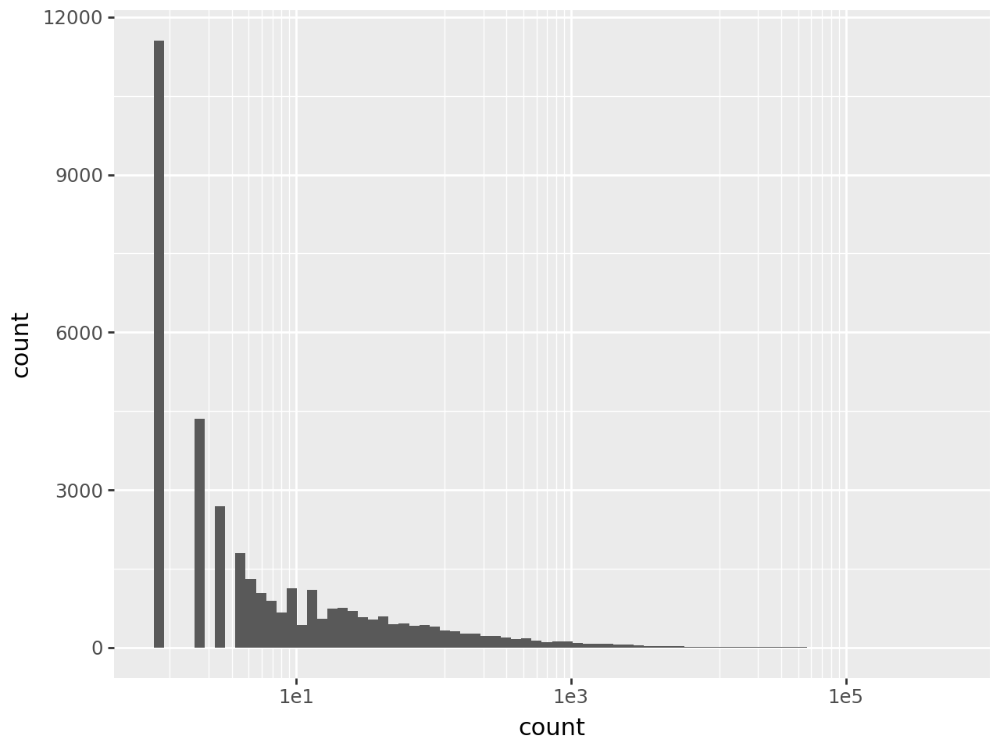

In [79]:
from plotnine import *
(
  ggplot(token_count_all) +
  geom_histogram(aes(x = "count")) +
  scale_x_log10()
)

In [81]:
token_count_all[token_count_all['word']=='diversity']

,word,count
4954,diversity,24


In [86]:
token_count_all[token_count_all['word'].str.len()>10].sort_values('count',ascending=False).head(10)

,word,count
2125,administration,2860
3962,Pennsylvania,2312
4013,Republicans,1826
2169,politicians,1739
607,unbelievable,1666
3785,enforcement,1586
2401,immigration,1430
882,immediately,1395
3223,manufacturing,1114
4138,regulations,1015


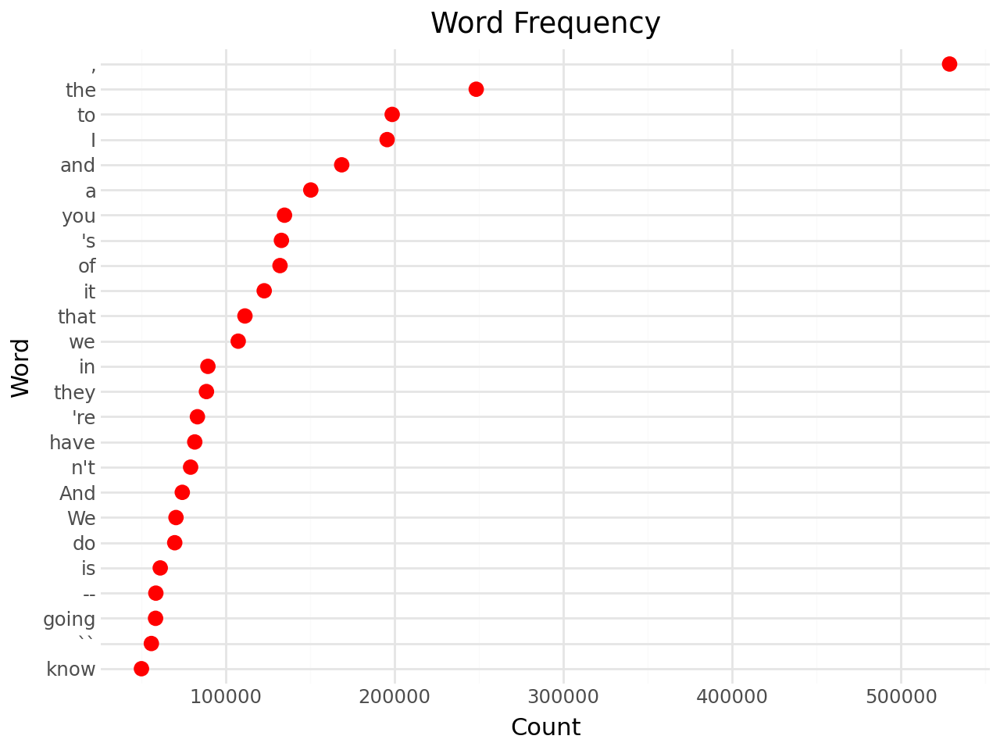

In [87]:
(
    ggplot(sorted_token_counts, aes(x='word', y='count')) +
    geom_point(stat='identity', size = 3, color = "red") +
    scale_x_discrete(
      limits=sorted_token_counts.sort_values("count")["word"].tolist()
    ) +
    coord_flip() +
    theme_minimal() +
    labs(title='Word Frequency', x='Word', y='Count')
)

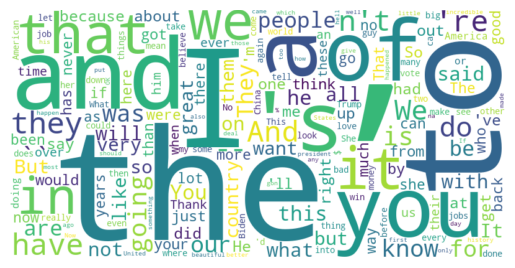

In [89]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud


wc = WordCloud(width=800, height=400, background_color="white")
wc = wc.generate_from_frequencies(token_counts)

plt.imshow(wc, interpolation="bilinear")
plt.axis("off")
plt.show()

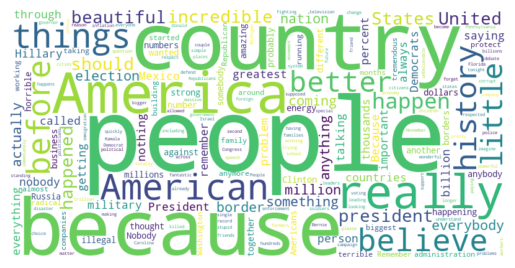

In [91]:
token_counts_long = Counter({w: c for w, c in token_counts.items() if len(w) > 5})
wc = WordCloud(width=800, height=400, background_color="white")
wc = wc.generate_from_frequencies(token_counts_long)
plt.imshow(wc, interpolation="bilinear")
plt.axis("off")
plt.show()


# Nettoyage de Texte

In [92]:
import nltk
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\nicol\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [93]:
from nltk.corpus import stopwords
", ".join(stopwords.words("english"))

"a, about, above, after, again, against, ain, all, am, an, and, any, are, aren, aren't, as, at, be, because, been, before, being, below, between, both, but, by, can, couldn, couldn't, d, did, didn, didn't, do, does, doesn, doesn't, doing, don, don't, down, during, each, few, for, from, further, had, hadn, hadn't, has, hasn, hasn't, have, haven, haven't, having, he, he'd, he'll, her, here, hers, herself, he's, him, himself, his, how, i, i'd, if, i'll, i'm, in, into, is, isn, isn't, it, it'd, it'll, it's, its, itself, i've, just, ll, m, ma, me, mightn, mightn't, more, most, mustn, mustn't, my, myself, needn, needn't, no, nor, not, now, o, of, off, on, once, only, or, other, our, ours, ourselves, out, over, own, re, s, same, shan, shan't, she, she'd, she'll, she's, should, shouldn, shouldn't, should've, so, some, such, t, than, that, that'll, the, their, theirs, them, themselves, then, there, these, they, they'd, they'll, they're, they've, this, those, through, to, too, under, until, up, 

In [95]:
!python -m spacy download en_core_web_sm
import spacy
nlp=spacy.load("en_core_web_sm")





[notice] A new release of pip is available: 25.1.1 -> 25.3
[notice] To update, run: python.exe -m pip install --upgrade pip


  Using cached https://github.com/explosion/spacy-models/releases/download/en_core_web_sm-3.8.0/en_core_web_sm-3.8.0-py3-none-any.whl (12.8 MB)
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')


In [96]:
stop_words_english = nlp.Defaults.stop_words
", ".join(stop_words_english)

"again, while, latterly, otherwise, thereupon, well, elsewhere, our, fifty, than, unless, ours, never, become, also, you, what, an, do, very, yet, using, may, twenty, per, same, most, therein, anyhow, themselves, does, each, something, yourselves, amongst, six, wherever, below, eight, by, herself, sometime, twelve, my, really, full, ’ll, anything, more, up, re, becomes, several, done, against, together, then, 've, get, enough, someone, another, yours, 'll, least, 're, five, within, over, even, front, formerly, call, ‘s, such, everyone, whereas, else, hereafter, these, whither, put, everything, ‘ve, ’ve, often, in, us, ‘ll, anyone, was, them, because, hers, bottom, please, himself, three, have, onto, none, whence, hundred, take, show, already, amount, without, under, cannot, it, of, after, noone, hereby, serious, neither, down, eleven, whose, ten, and, ‘d, own, ca, here, his, rather, various, beyond, she, am, somewhere, among, around, 'm, did, move, fifteen, were, towards, upon, seem, e

In [98]:
cleaned_tokens=[token.lemma_ for token in nlp(clean_text) if not token.is_punct and not token.is_stop]

ValueError: [E088] Text of length 38680015 exceeds maximum of 1000000. The parser and NER models require roughly 1GB of temporary memory per 100,000 characters in the input. This means long texts may cause memory allocation errors. If you're not using the parser or NER, it's probably safe to increase the `nlp.max_length` limit. The limit is in number of characters, so you can check whether your inputs are too long by checking `len(text)`.

# Transformation de ce notebook de test en script

In [2]:
import sqlite3
import pandas as pd
import os

def load_transcriptions():
    db_path = os.path.join("..", "..", "data", "speeches.db")
    with sqlite3.connect(db_path) as conn:
        return pd.read_sql_query("SELECT text FROM Transcriptions", conn)["text"]
load_transcriptions()

0         [Audience chants "USA"] Well, that was good ti...
1         We appreciate it. Thank you, Navy. Thank you v...
2         They do. And let me say to all of the incredib...
3         You know, a lot of people don't. [Laughs] [Aud...
4         And it's a true honor to be here with the thou...
                                ...                        
120363    And the people of America have never lost fait...
120364    And perhaps most beautifully of all, we have m...
120365    We are going to have hope, harmony, opportunit...
120366    This has been truly an honor. It's, uh, seldom...
120367    Thank you everybody. Good luck. Thank you very...
Name: text, Length: 120368, dtype: object

In [ ]:
import re 
def build_clean_text(phrases):
    pieces = []
    for phrase in phrases.dropna():
        chunks = [re.sub(r"\[.*?\]", "", part).strip()
                  for part in re.split(r"[.!?]+", str(phrase))]
        pieces.extend(filter(None, chunks))
    return " ".join(pieces)